## Setup

In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np

from tqdm.notebook import tqdm

import matplotlib
import matplotlib.pyplot as plt
import plotly.io as pio
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [3]:
# @title Styling
# @markdown Making things pretty! (This is meant to work with Colab's dark theme **(Settings > Site > Theme > "Dark")**.)
# import google
# is_dark = google.colab.output.eval_js(
#     'document.documentElement.matches("[theme=dark]")'
# )

matplotlib.rcParams["figure.dpi"] = 100
plt.rcParams["hatch.color"] = "white"

# if is_dark:
# load style sheet for matplotlib, a plotting library we use for 2D visualizations
plt.style.use(
    "https://github.com/dhaitz/matplotlib-stylesheets/raw/master/pitayasmoothie-dark.mplstyle"
)
plt.style.use("dark_background")
plt.rcParams.update(
    {
        "figure.facecolor": (0.22, 0.22, 0.22, 1.0),
        "axes.facecolor": (0.22, 0.22, 0.22, 1.0),
        "savefig.facecolor": (0.22, 0.22, 0.22, 1.0),
        "grid.color": (0.4, 0.4, 0.4, 1.0),
    }
)

plotly_template = pio.templates["plotly_dark"]
pio.templates["draft"] = go.layout.Template(
    layout=dict(
        plot_bgcolor="rgba(56,56,56,0)",
        paper_bgcolor="rgba(56,56,56,0)",
    )
)
pio.templates.default = "plotly_dark+draft"
    

In [4]:
device = 'cuda' if torch.cuda.is_available() else 'device'
print(f"Using {device}")

Using cuda


## Net

In [5]:
from mlp import MLP
from heat import PINN_1D

Using cuda
Using cuda


## Heat 1D

### Basic Diffusion

100%|██████████| 1000/1000 [00:11<00:00, 87.56it/s]


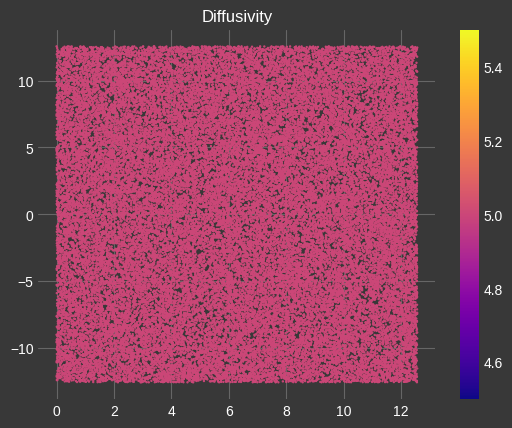

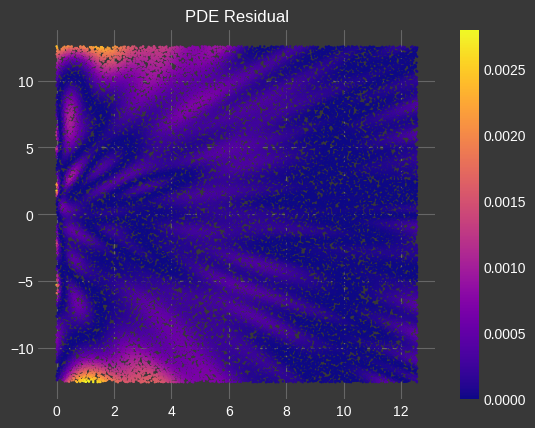

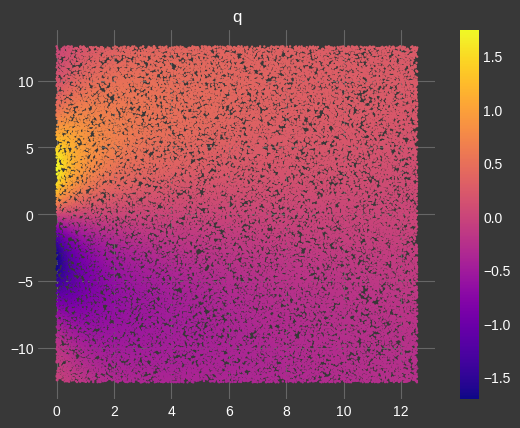

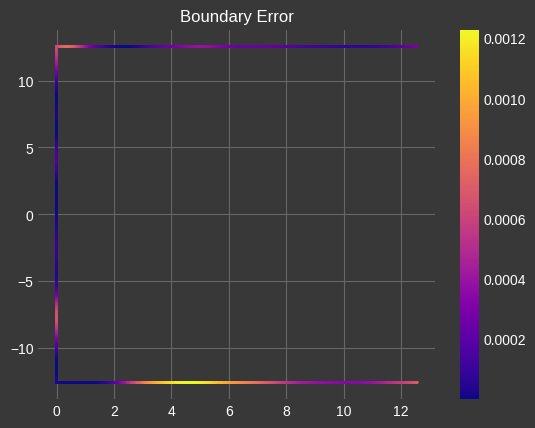

In [10]:
d_fn = lambda pts: pts[:,1:2]*0 + 5

ic_fn = lambda pts: 15*(1/(3*np.sqrt(2*np.pi)))*torch.exp(-(pts[:,1:2])**2 / (2*3.5**2))

bc_fn = ic_fn

pinn = PINN_1D(
    net=MLP(hidden_layer_ct=4,hidden_dim=256, act=F.tanh, learnable_act="SINGLE"), 
    initial_ct=250, 
    collocation_ct=1000, 
    d_fn=d_fn,
    ic_fn=ic_fn,
    bc_fn=bc_fn,
    boundary_type=["dirchelet","dirchelet"],
    t_bounds=[0,4*np.pi], 
    space_bounds=[-4*np.pi, 4*np.pi],
    lr=1e-3,
    adaptive_resample=True
)
pinn.train(n_epochs=1000, reporting_frequency=100)
pinn.plot_3d()
pinn.plot_config_and_res()

### Dealing with Discontinuities

100%|██████████| 1000/1000 [00:10<00:00, 91.71it/s]


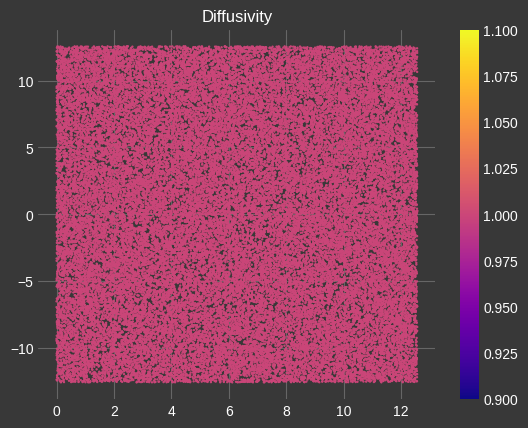

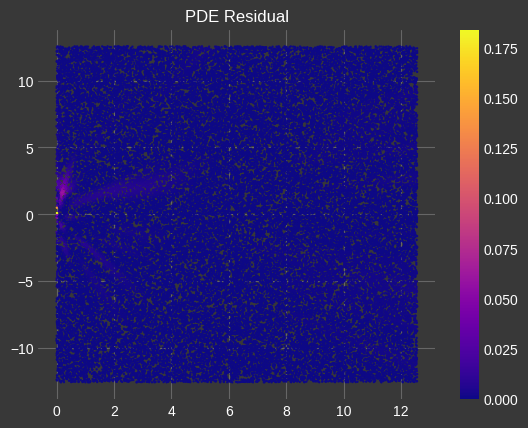

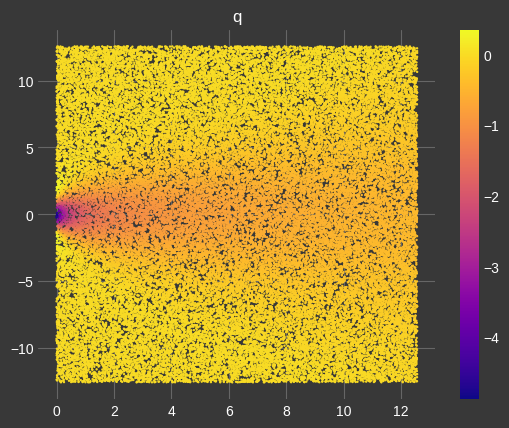

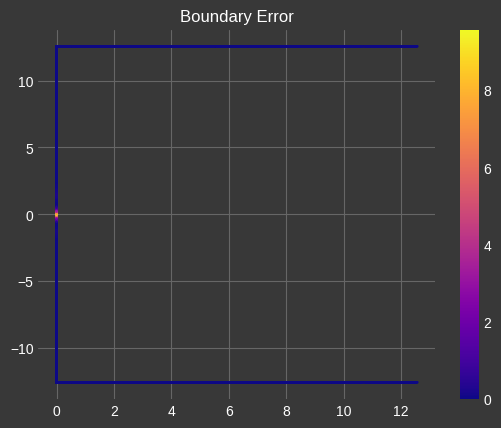

In [30]:

d_fn = lambda pts: (pts[:,1:2])*0 + 1
ic_fn = lambda pts: torch.sign(pts[:,1:2])*3
bc_fn = ic_fn

pinn = PINN_1D(
    net=MLP(hidden_layer_ct=4,hidden_dim=256, act=F.tanh, learnable_act="SINGLE"), 
    initial_ct=250, 
    collocation_ct=1000, 
    d_fn=d_fn,
    ic_fn=ic_fn,
    bc_fn=bc_fn,
    boundary_type=["dirchelet","dirchelet"],
    t_bounds=[0,4*np.pi], 
    space_bounds=[-4*np.pi, 4*np.pi],
    lr=1e-3,
    adaptive_resample=True
)
pinn.train(n_epochs=1000, reporting_frequency=100)
pinn.plot_config_and_res()
pinn.plot_3d()

Solution - use smooth approximations!

100%|██████████| 1000/1000 [00:10<00:00, 92.56it/s]


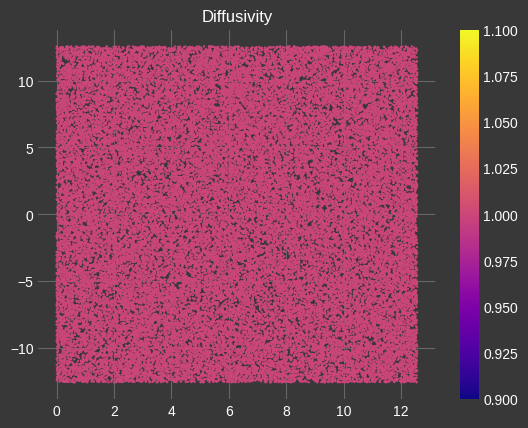

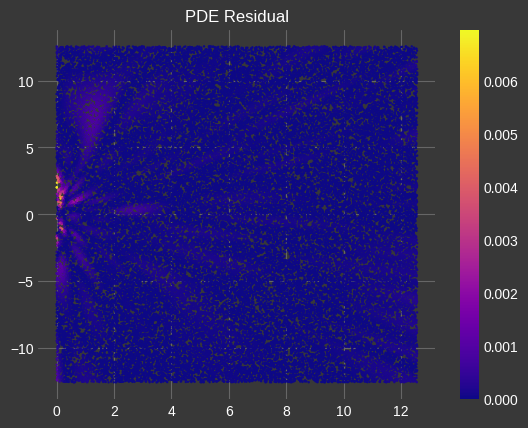

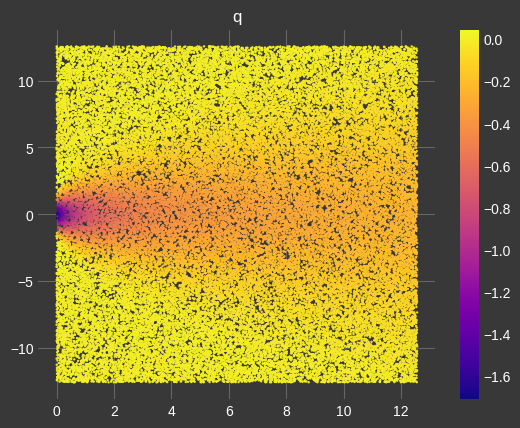

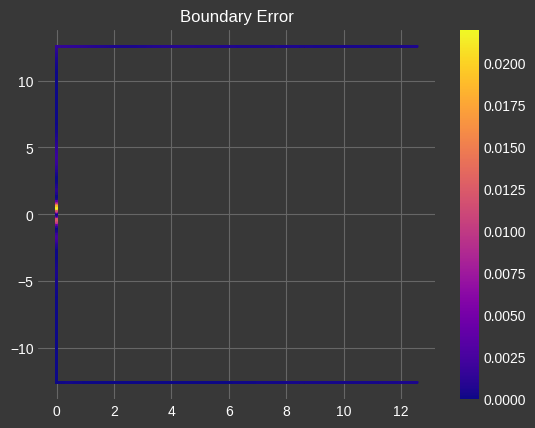

In [31]:

d_fn = lambda pts: (pts[:,1:2])*0 + 1
ic_fn = lambda pts: torch.sigmoid(pts[:,1:2]*3)*3
bc_fn = ic_fn

pinn = PINN_1D(
    net=MLP(hidden_layer_ct=4,hidden_dim=256, act=F.tanh, learnable_act="SINGLE"), 
    initial_ct=250, 
    collocation_ct=1000, 
    d_fn=d_fn,
    ic_fn=ic_fn,
    bc_fn=bc_fn,
    boundary_type=["dirchelet","dirchelet"],
    t_bounds=[0,4*np.pi], 
    space_bounds=[-4*np.pi, 4*np.pi],
    lr=1e-3,
    adaptive_resample=True
)
pinn.train(n_epochs=1000, reporting_frequency=100)
pinn.plot_config_and_res()
pinn.plot_3d()

### Spatially Varying Diffusivity

100%|██████████| 1000/1000 [00:11<00:00, 89.50it/s]


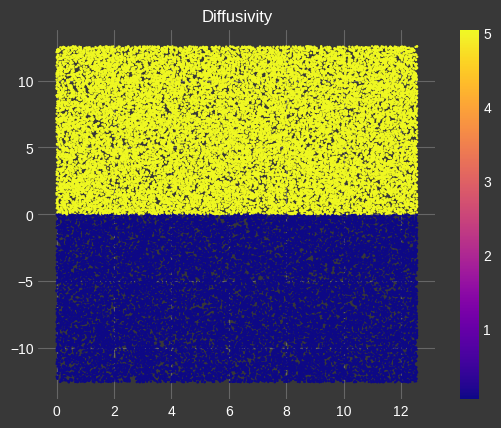

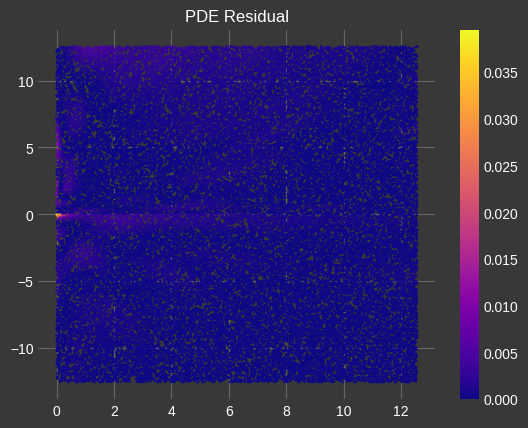

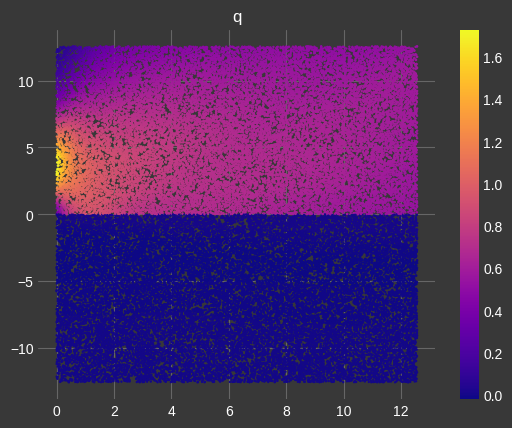

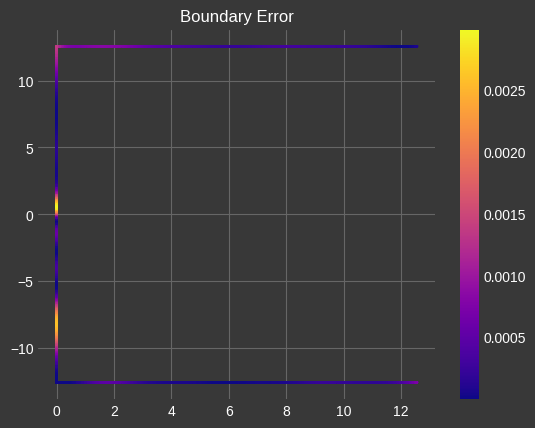

In [11]:
d_fn = lambda pts: torch.sigmoid(torch.sign(pts[:,1:2])*8)*5 + 0.05
ic_fn = lambda pts: 15*(1/(3*np.sqrt(2*np.pi)))*torch.exp(-(pts[:,1:2])**2 / (2*3.5**2))
bc_fn = ic_fn

pinn = PINN_1D(
    net=MLP(hidden_layer_ct=4,hidden_dim=256, act=F.tanh, learnable_act="SINGLE"), 
    initial_ct=250, 
    collocation_ct=1000, 
    d_fn=d_fn,
    ic_fn=ic_fn,
    bc_fn=bc_fn,
    boundary_type=["dirchelet","dirchelet"],
    t_bounds=[0,4*np.pi], 
    space_bounds=[-4*np.pi, 4*np.pi],
    lr=1e-3,
    adaptive_resample=True
)
pinn.train(n_epochs=1000, reporting_frequency=100)
pinn.plot_config_and_res()
pinn.plot_3d()

### Unsatisfiable BCs

100%|██████████| 2000/2000 [00:22<00:00, 90.79it/s] 


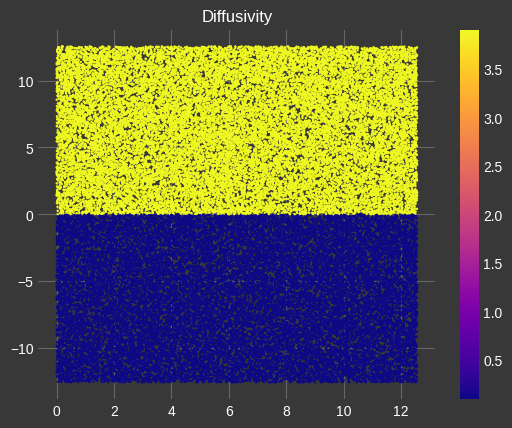

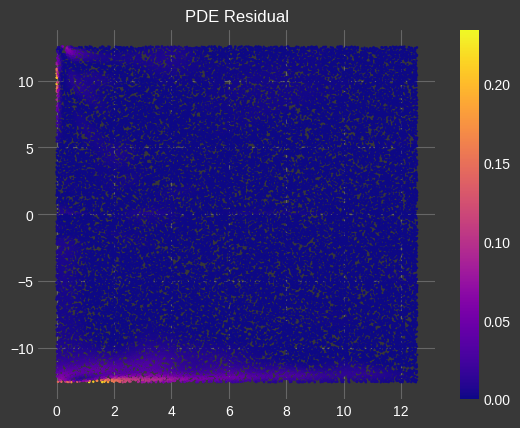

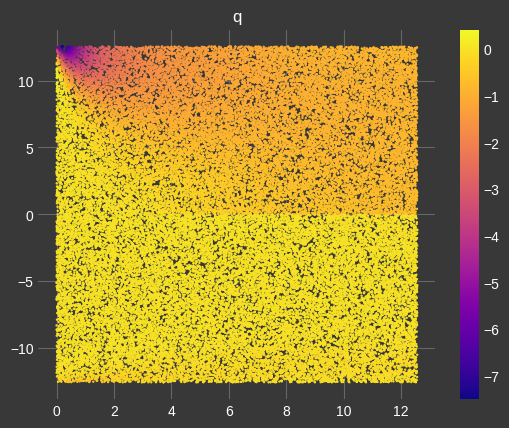

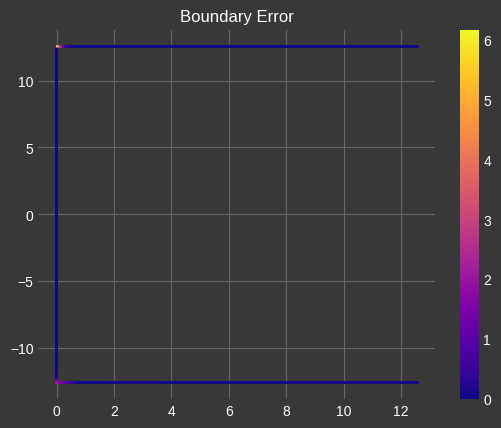

In [40]:
d_fn = lambda pts: (torch.sigmoid(torch.sign(pts[:,1:2])*2)-0.2)*5 + 0.5
ic_fn = lambda pts: pts[:,1:2]*0
bc_fn = lambda pts: torch.sign(pts[:,1:2])*3

pinn = PINN_1D(
    net=MLP(hidden_layer_ct=4,hidden_dim=256, act=F.tanh, learnable_act="SINGLE"), 
    initial_ct=250, 
    collocation_ct=1000, 
    d_fn=d_fn,
    ic_fn=ic_fn,
    bc_fn=bc_fn,
    boundary_type=["dirchelet","dirchelet"],
    t_bounds=[0,4*np.pi], 
    space_bounds=[-4*np.pi, 4*np.pi],
    lr=1e-3,
    adaptive_resample=True
)
pinn.train(n_epochs=2000, reporting_frequency=100)
pinn.plot_config_and_res()
pinn.plot_3d()

### Time Varying Prescriptive BCs

100%|██████████| 2000/2000 [00:22<00:00, 89.07it/s]


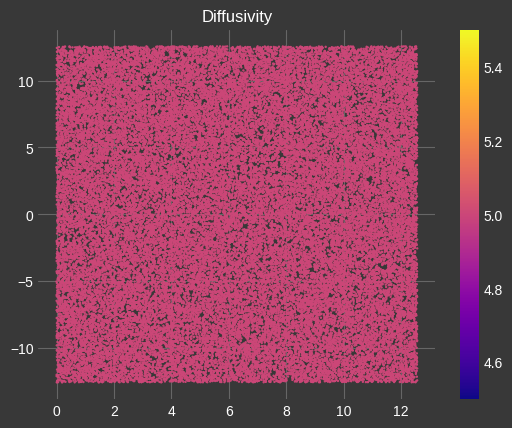

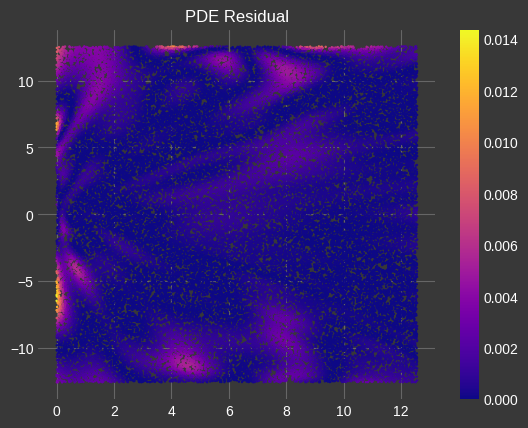

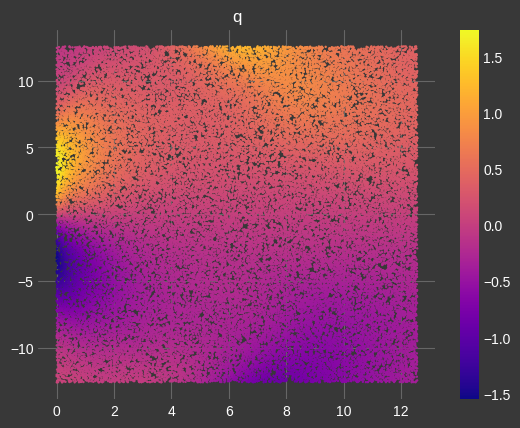

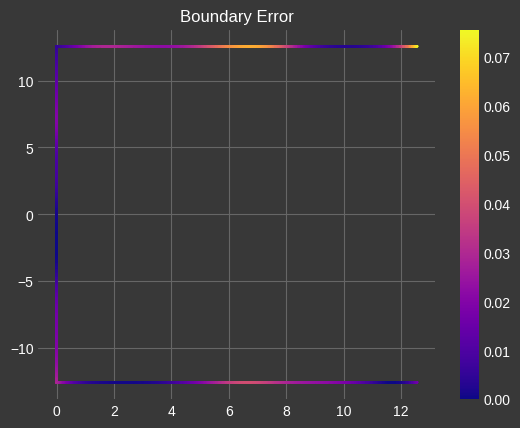

In [18]:
d_fn = lambda pts: pts[:,1:2]*0 + 5
ic_fn = lambda pts: 15*(1/(3*np.sqrt(2*np.pi)))*torch.exp(-(pts[:,1:2])**2 / (2*3.5**2))
bc_fn = lambda pts: torch.sin(pts[:,0:1]/2)*0.4 + ic_fn(pts)

pinn = PINN_1D(
    net=MLP(hidden_layer_ct=4,hidden_dim=256, act=F.tanh, learnable_act="SINGLE"), 
    initial_ct=250, 
    collocation_ct=1000, 
    d_fn=d_fn,
    ic_fn=ic_fn,
    bc_fn=bc_fn,
    boundary_type=["dirchelet","dirchelet"],
    t_bounds=[0,4*np.pi], 
    space_bounds=[-4*np.pi, 4*np.pi],
    lr=1e-3,
    adaptive_resample=True
)
pinn.train(n_epochs=2000, reporting_frequency=100)
pinn.plot_3d()
pinn.plot_config_and_res()

Struggles with High Frequency Content!

100%|██████████| 2000/2000 [00:22<00:00, 89.76it/s]


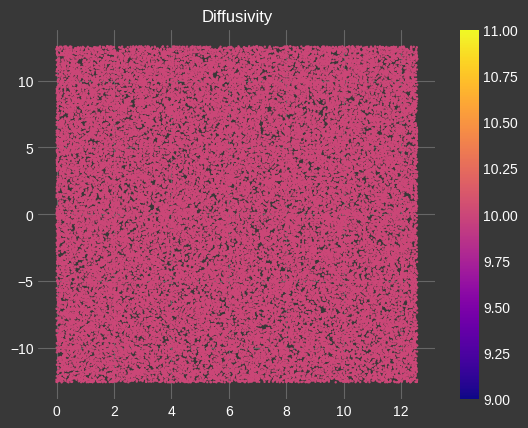

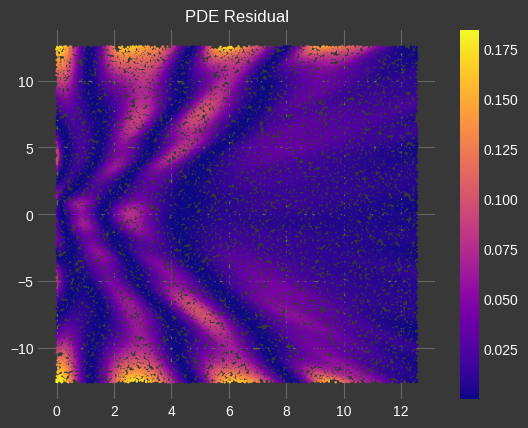

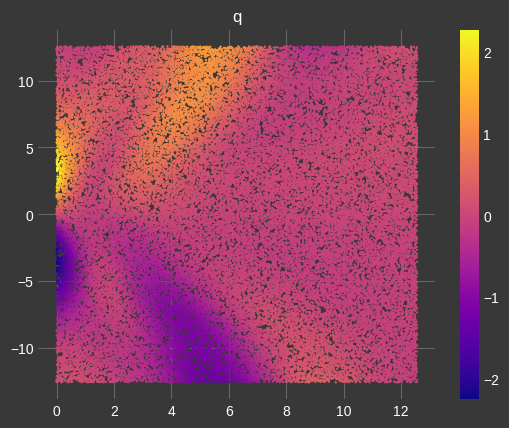

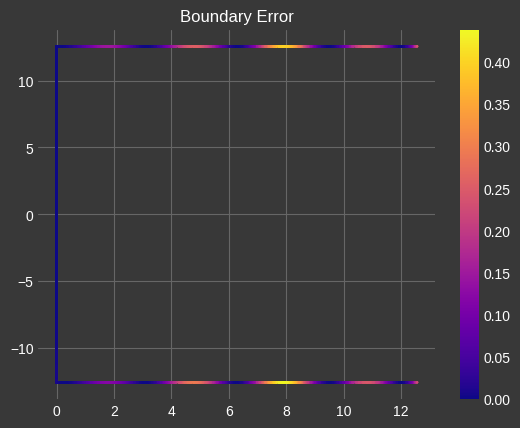

In [24]:

d_fn = lambda pts: pts[:,1:2]*0 + 10
ic_fn = lambda pts: 10*(1/(3*np.sqrt(2*np.pi)))*torch.exp(-(pts[:,1:2])**2 / (2*3.5**2))
bc_fn = lambda pts: torch.sin(pts[:,0:1])*0.8 + ic_fn(pts)

pinn = PINN_1D(
    net=MLP(hidden_layer_ct=4,hidden_dim=256, act=F.tanh, learnable_act="SINGLE"), 
    initial_ct=250, 
    collocation_ct=1000, 
    d_fn=d_fn,
    ic_fn=ic_fn,
    bc_fn=bc_fn,
    boundary_type=["dirchelet","dirchelet"],
    t_bounds=[0,4*np.pi], 
    space_bounds=[-4*np.pi, 4*np.pi],
    lr=1e-4,
    adaptive_resample=True
)
pinn.train(n_epochs=2000, reporting_frequency=100)
pinn.plot_3d()
pinn.plot_config_and_res()